# Stable Diffussion Play Around

## Initial Setup

In [2]:
!pip install diffusers transformers fastcore

  Using cached diffusers-0.4.1-py3-none-any.whl (229 kB)
  Using cached transformers-4.23.1-py3-none-any.whl (5.3 MB)
  Using cached fastcore-1.5.27-py3-none-any.whl (67 kB)
  Using cached huggingface_hub-0.10.1-py3-none-any.whl (163 kB)
  Using cached tokenizers-0.13.1-cp38-cp38-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (7.6 MB)

[notice] A new release of pip available: 22.1.2 -> 22.2.2
[notice] To update, run: pip install --upgrade pip


In [3]:
from PIL import Image
from fastcore.all import concat
import torch, logging
from pathlib import Path
from huggingface_hub import notebook_login
from diffusers import StableDiffusionPipeline
from PIL import Image
import matplotlib.pyplot as plt
logging.disable(logging.WARNING)
torch.manual_seed(1)

In [4]:
if not (Path.home()/'.huggingface'/'token').exists(): notebook_login()

## Hello World

In [5]:
pipe = StableDiffusionPipeline.from_pretrained("CompVis/stable-diffusion-v1-4", revision="fp16", torch_dtype=torch.float16).to("cuda")

Fetching 16 files:   0%|          | 0/16 [00:00<?, ?it/s]

In [15]:
#!du -h ~/.cache/huggingface/

  0%|          | 0/51 [00:00<?, ?it/s]

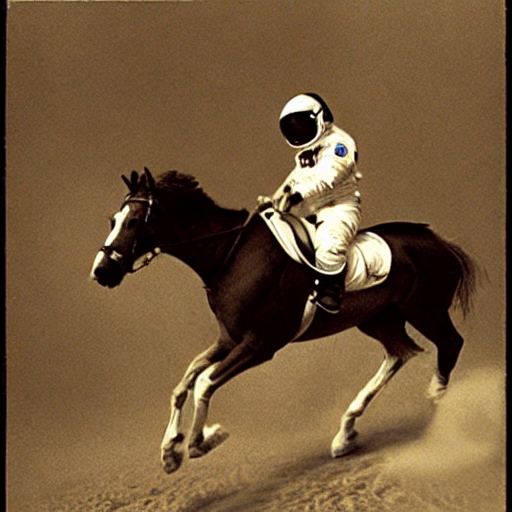

In [7]:
prompt = "a photograph of an astronaut riding a horse"
pipe(prompt).images[0]

  0%|          | 0/51 [00:00<?, ?it/s]

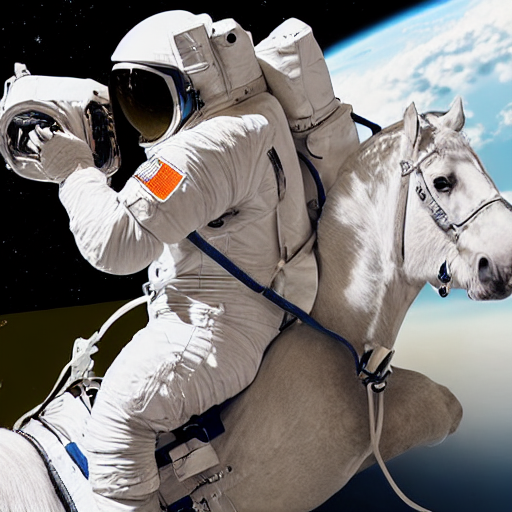

In [24]:
## With a Seed
torch.manual_seed(2223)
pipe(prompt).images[0]

## Steps

Here, we use steps to let it generate some decent image. 50 seems like the good solution.
But we can of course change it. Let's give it a try.

In [8]:
def image_grid(imgs, rows, cols):
    w,h = imgs[0].size
    grid = Image.new('RGB', size=(cols*w, rows*h))
    for i, img in enumerate(imgs): grid.paste(img, box=(i%cols*w, i//cols*h))
    return grid

In [17]:
#let do it for couple of steps
images = concat(pipe(prompt, num_inference_steps=i).images for i in [1, 3, 16, 30, 50, 100])
images

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/17 [00:00<?, ?it/s]

  0%|          | 0/31 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/101 [00:00<?, ?it/s]

[<PIL.Image.Image image mode=RGB size=512x512 at 0x7F744662A490>,
 <PIL.Image.Image image mode=RGB size=512x512 at 0x7F74469A0F10>,
 <PIL.Image.Image image mode=RGB size=512x512 at 0x7F74465CBBE0>,
 <PIL.Image.Image image mode=RGB size=512x512 at 0x7F74465D5E20>,
 <PIL.Image.Image image mode=RGB size=512x512 at 0x7F74465F0AC0>,
 <PIL.Image.Image image mode=RGB size=512x512 at 0x7F74465F9C10>]

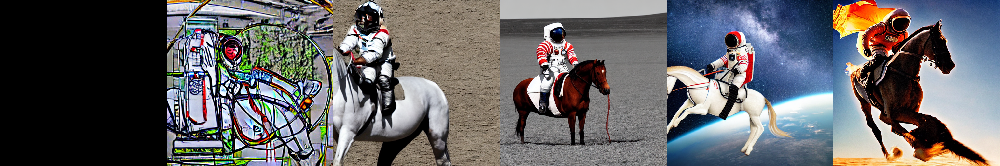

In [19]:
image_grid(images, 1, 6)

**As you can see, there not much difference between 50 & 100. Even the difference between 30 & 50 is also minimum.**

*It seems like 50 is the golden standard*

## Guidance Scale

This is basically about using the given propmt or not. 

* A lower values means, not really looking at the prompt.
* Higer values means, it looking at the prompt a lot.

In [22]:
images = concat(pipe([prompt]*6, guidance_scale=i).images for i in [1, 4, 7, 15, 20])

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

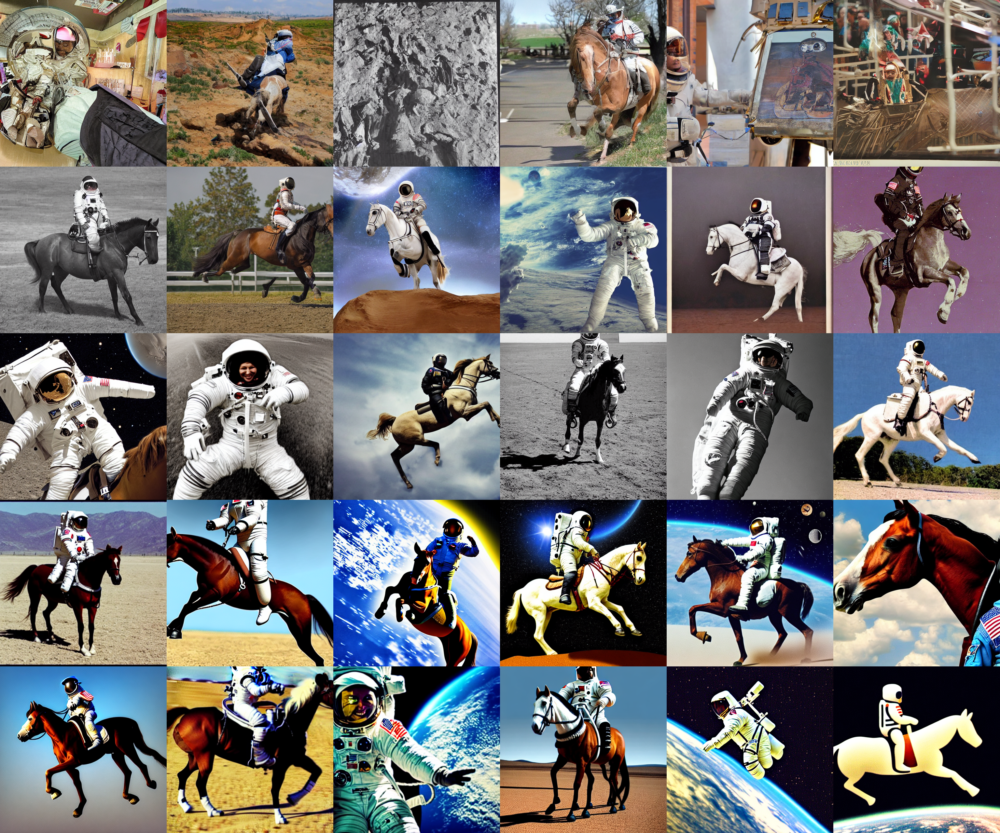

In [23]:
image_grid(images, 5, 6)

That's interesting.

* 1 is totally BS
* 4 & 7 gives us interesting results
* 15 & 20 follow the prompt, but they are bit sketchy & may be not in high quality